In [1]:
#dependencies
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
from matplotlib.lines import Line2D

In [2]:
#reading in the state abbreviations
path = '../google_trends/statesAbbrev.csv'
statesAbbrev_df = pd.read_csv(path)
statesAbbrev_df.tail(12)

,State,Abbrev,Code
39,Rhode Island,R.I.,RI
40,South Carolina,S.C.,SC
41,South Dakota,S.D.,SD
42,Tennessee,Tenn.,TN
43,Texas,Tex.,TX
44,Utah,Utah,UT
45,Vermont,Vt.,VT
46,Virginia,Va.,VA
47,Washington,Wash.,WA
48,West Virginia,W.Va.,WV


In [3]:
#list for state codes
state_codes = [x for x in statesAbbrev_df['Code']]

In [34]:
#list for state names
state_names = [x for x in statesAbbrev_df['State']]

In [35]:
#creating lowercase no space state names appropriate for file names
state_names_for_files = [x.lower().replace(" ", "_") for x in state_names]

In [7]:
#creating a df dict to hold the state dfs, reading in the dfs
states_df_dict = {}
for x in range(40, 51):
    path = f'../google_trends/google_trends_csvs/state_csvs/US-{state_codes[x]}_cat_data.csv'
    states_df_dict[f'{state_codes[x]}_data_df'] = [pd.read_csv(path)]

In [8]:
#inspecting the keys (ie df names)
states_df_dict.keys()

dict_keys(['SC_data_df', 'SD_data_df', 'TN_data_df', 'TX_data_df', 'UT_data_df', 'VT_data_df', 'VA_data_df', 'WA_data_df', 'WV_data_df', 'WI_data_df', 'WY_data_df'])

In [9]:
#test printing a df
print(state_codes[40])
states_df_dict[f'{state_codes[40]}_data_df'][0].head(10)

SC


,time,arts_entertainment,autos,beauty_fitness,books_lit,action_adventure,campaigns_elections,celebs,discrimination,entertainment_media,...,mobiles,online_vids,scifi_fantasy,sport_news,tv_shows,voice_vid_chat,weather,covid_cases,stay_at_home,mass_gathering_ban
0,2019-01-06,96,78,70,87,68,0,65,22,68,...,60,92,66,80,91,37,59,NaN,False,False
1,2019-01-13,95,76,73,87,74,0,66,10,83,...,61,87,54,48,79,35,68,NaN,False,False
2,2019-01-20,88,80,71,81,69,0,61,18,73,...,62,83,55,54,89,41,68,NaN,False,False
3,2019-01-27,93,76,70,83,71,0,66,17,80,...,61,94,43,44,83,48,69,NaN,False,False
4,2019-02-03,92,78,72,88,65,0,61,26,60,...,61,81,42,73,89,58,57,NaN,False,False
5,2019-02-10,95,80,68,92,58,0,63,20,72,...,64,91,51,47,78,43,70,NaN,False,False
6,2019-02-17,95,82,76,90,66,0,78,23,67,...,67,91,40,40,83,53,80,NaN,False,False
7,2019-02-24,100,84,73,94,64,0,69,25,68,...,64,87,55,45,86,70,74,NaN,False,False
8,2019-03-03,97,82,72,93,63,0,59,46,75,...,70,89,51,39,91,52,76,NaN,False,False
9,2019-03-10,93,83,68,86,55,0,68,22,66,...,64,84,46,63,84,55,58,NaN,False,False


In [10]:
col_names = list(states_df_dict[f'{state_codes[40]}_data_df'][0].columns)

In [26]:
cat_names = [x for x in col_names if x not in ['time', 'covid_cases', 'stay_at_home', 'mass_gathering_ban']]

In [12]:
times_list = list(states_df_dict[f'{state_codes[40]}_data_df'][0]['time'])

In [13]:
#getting rid of the nans in the covid cases columns (replacing with zeros)
for x in range(40, 51):
    states_df_dict[f'{state_codes[x]}_data_df'][0]['covid_cases'] = states_df_dict[f'{state_codes[x]}_data_df'][0]['covid_cases'].fillna(0)
    
    

In [14]:
#test printing a df to see if covid cols have nans
states_df_dict[f'{state_codes[44]}_data_df'][0].head()

,time,arts_entertainment,autos,beauty_fitness,books_lit,action_adventure,campaigns_elections,celebs,discrimination,entertainment_media,...,mobiles,online_vids,scifi_fantasy,sport_news,tv_shows,voice_vid_chat,weather,covid_cases,stay_at_home,mass_gathering_ban
0,2019-01-06,98,64,96,94,57,0,57,20,85,...,58,85,47,65,91,26,57,0.0,False,False
1,2019-01-13,93,63,96,86,71,0,58,29,78,...,60,84,44,66,88,26,66,0.0,False,False
2,2019-01-20,92,62,89,86,72,0,57,32,76,...,58,74,39,55,85,31,58,0.0,False,False
3,2019-01-27,92,61,91,87,53,0,64,32,81,...,51,75,35,54,81,57,53,0.0,False,False
4,2019-02-03,93,64,91,81,70,0,58,27,72,...,49,73,47,73,86,53,91,0.0,False,False


In [16]:
#finding values that are one stdev away for a test df
for x in range(0, len(cat_names)):
    print(cat_names[x])
    stdev = states_df_dict[f'{state_codes[45]}_data_df'][0].std()[x]
    mean_for_state = states_df_dict[f'{state_codes[45]}_data_df'][0][f'{cat_names[x]}'].mean()
    topline = mean_for_state + stdev
    bottomline = mean_for_state - stdev
    print(f'topline: {topline}')
    print(f'bottomline: {bottomline}')

arts_entertainment
topline: 89.15506665095158
bottomline: 76.78668092186395
autos
topline: 86.40898454752667
bottomline: 66.85315137480342
beauty_fitness
topline: 86.66281077312092
bottomline: 70.75466495503443
books_lit
topline: 84.51708319024485
bottomline: 59.89068380004641
action_adventure
topline: 66.4313451542736
bottomline: 41.840499505920576
campaigns_elections
topline: 11.738410106628614
bottomline: -8.029672242550944
celebs
topline: 63.7246028807872
bottomline: 38.00355245901862
discrimination
topline: 48.478120359851076
bottomline: 8.919937892576108
entertainment_media
topline: 71.8210393122371
bottomline: 45.8294461246561
games_systems_consoles
topline: 70.69648097001247
bottomline: 38.44915009794869
health_news
topline: 68.36530150394853
bottomline: 19.40168878731361
infectious_diseases
topline: 29.558183722628947
bottomline: 0.8884182191186252
law_enf
topline: 62.62844865338177
bottomline: 34.517182414579395
lottos
topline: 66.69743796024909
bottomline: 37.24430961256643


In [30]:
def stdev_mean_graph_maker(ind_no):
    all_data_df = states_df_dict[f'{state_codes[ind_no]}_data_df'][0]
    data_2019_df = all_data_df.iloc[:52, :]
    data_2020_df = all_data_df.iloc[52:, :]
    
    graphs_time_list = [x for x in all_data_df['time']]
    init_covid_list = [x for x in all_data_df['covid_cases']]
    
    for n in range(0, len(cat_names)):
        stdev_2019 = data_2019_df.std()[n]
        mean_for_state_2019 = data_2019_df[f'{cat_names[n]}'].mean()
        topline_2019 = mean_for_state_2019 + stdev_2019
        bottomline_2019 = mean_for_state_2019 - stdev_2019
        
        stdev_2020 = data_2020_df.std()[n]
        mean_for_state_2020 = data_2020_df[f'{cat_names[n]}'].mean()
        topline_2020 = mean_for_state_2020 + stdev_2020
        bottomline_2020 = mean_for_state_2020 - stdev_2020
        
        fig, ax = plt.subplots(figsize=(30,7))
        
        ax.plot(graphs_time_list, all_data_df[f'{cat_names[n]}'], color='black')
        
        ax.axhline(y=mean_for_state_2019, color='blue', linestyle='--', label='mean line 2019')
        
        ax.axhline(y=mean_for_state_2020, color='green', linestyle='--', label='mean line 2020')
        
        ax.axhline(y=topline_2019, color='blue', linestyle=':', label= '+1SD 2019')
        
        ax.axhline(y=bottomline_2019, color='blue', linestyle=':', label='-1SD 2019')
        
        ax.axhline(y=topline_2020, color='green', linestyle=':', label='+1SD 2020')
        
        ax.axhline(y=bottomline_2020, color='green', linestyle=':', label='-1SD 2020')
        
        ax.axvspan(graphs_time_list[51], graphs_time_list[52], facecolor='r', alpha=0.5)
        
        plt.xticks(graphs_time_list, rotation=90)
        
        plt.grid()
        plt.xlabel('date')
        plt.ylabel('% popularity')
        plt.legend(loc='upper left', ncol=3)
        plt.title(f'{state_names[ind_no]}: Popularity of Category {cat_names[n]} 2019-2020, and Covid Cases (2020), with StDev and Mean Lines for 2019 and 2020')
        
        ax2 = ax.twinx()
        colour_list = []
        for x in all_data_df['stay_at_home']:
            if x == True:
                colour_list.append('green')
            else:
                colour_list.append('blue')
        ax2.set_ylabel('covid_cases')  
        ax2.bar(graphs_time_list, init_covid_list, color=colour_list, align='center', alpha=0.3)
        ax2.tick_params(axis='y')
    
        custom_lines = [Line2D([0], [0], color='green', alpha=0.5, lw=3),
                    Line2D([0], [0], color='blue', alpha=0.5, lw=3)]

        ax2.legend(custom_lines, ['stay_at_home in effect', 'no stay_at_home'], loc='lower left')
        fig.tight_layout()  # otherwise the right y-label is slightly clipped
        
        plt.savefig(f'graphs_for_states/stdev_means_lines_graphs/{cat_names[n]}/{state_names_for_files[ind_no]}_{cat_names[n]}_graph.png')

        plt.show()

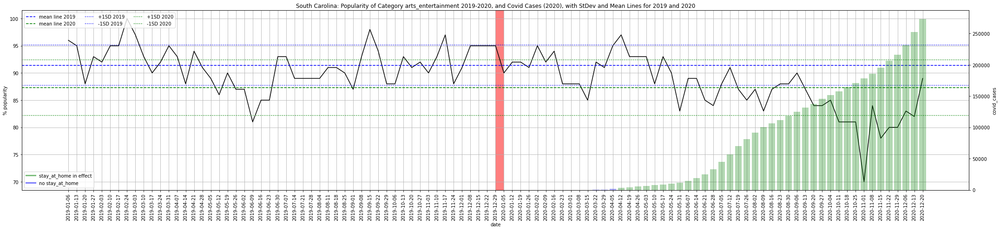

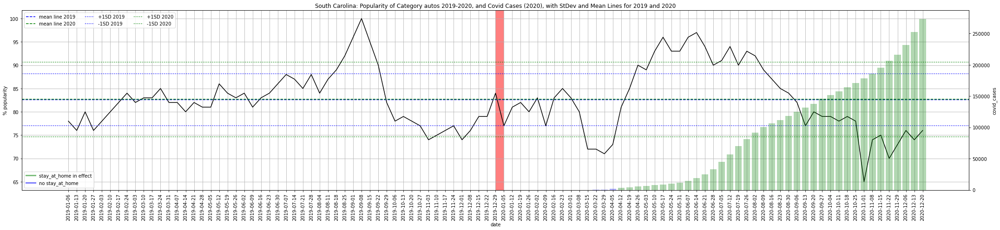

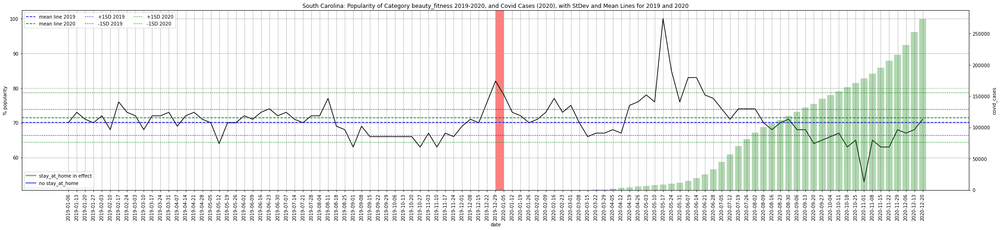

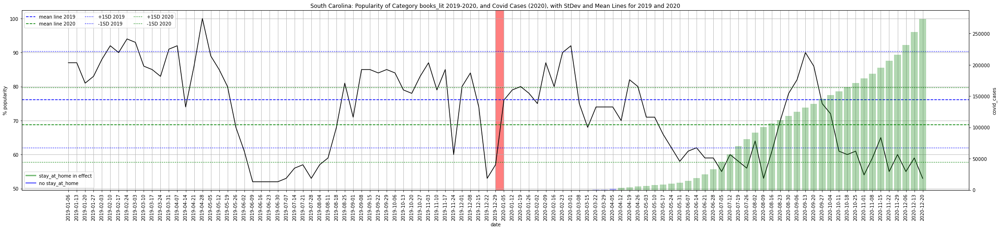

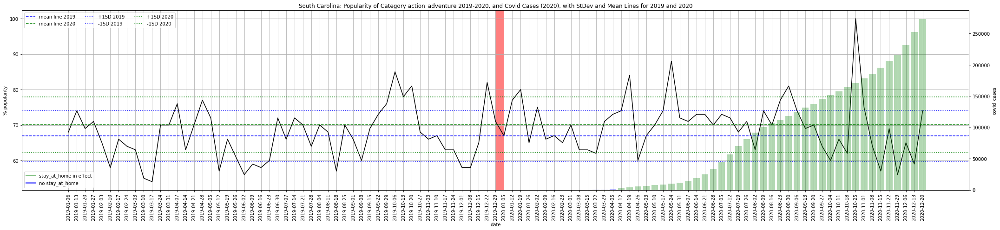

...

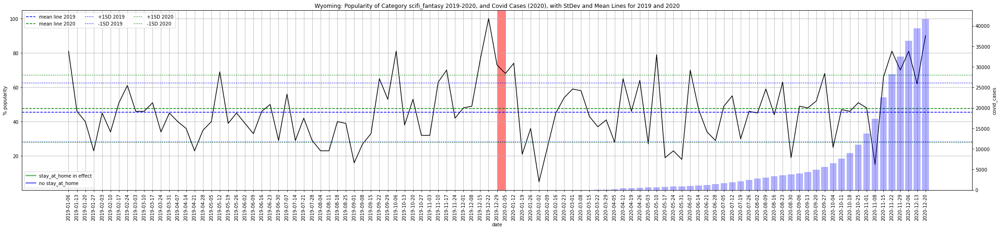

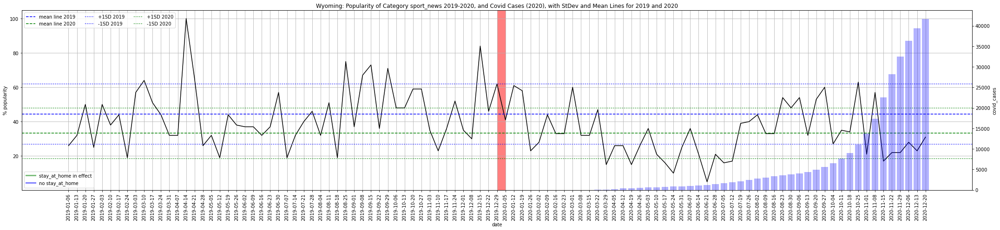

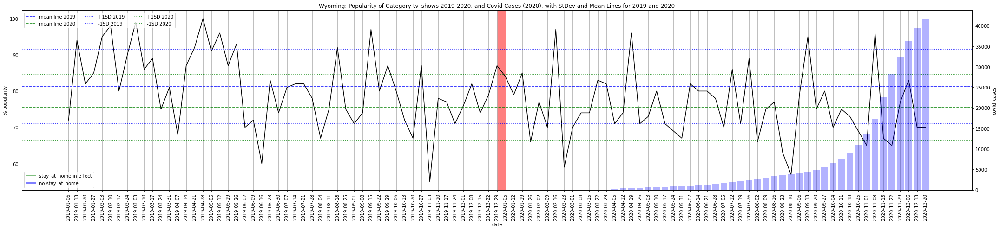

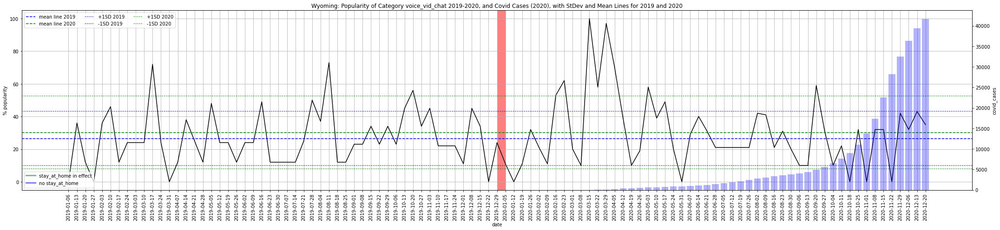

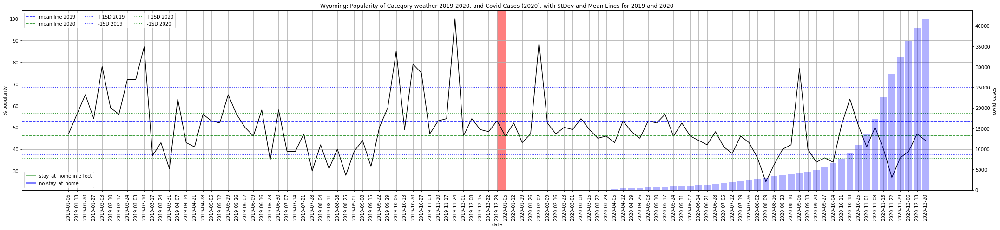

In [31]:
for x in range(40, 51):
    stdev_mean_graph_maker(x)